Preprocess Adience 

In [1]:
import os
import random 
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [2]:
import torch

print("CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("GPU:", torch.cuda.get_device_name(0))

CUDA available: True
GPU: NVIDIA GeForce RTX 4060 Laptop GPU


In [3]:
import os
import re
import pandas as pd

ADIENCE_PATH = "C:/Users/Kelly/Downloads/SC4001/Adience"

# List all files in the folder
files = os.listdir(ADIENCE_PATH)
print(files)

all_folds = {}
# Define a regular expression to match files like 'fold_0_data.txt', 'fold_1_data.txt', etc.
pattern = re.compile(r'^fold_(\d+)_data\.txt$')

for file in files:
    match = pattern.match(file)
    if match:
        fold_num = int(match.group(1))
        file_path = os.path.join(ADIENCE_PATH, file)
        all_folds[fold_num] = pd.read_csv(file_path, sep="\t")

# (Optional) Sort the dictionary by the fold numbers if desired
all_folds = dict(sorted(all_folds.items()))


['fold_0_data.txt', 'fold_1_data.txt', 'fold_2_data.txt', 'fold_3_data.txt', 'fold_4_data.txt']


In [4]:
# Concatenate all dataframes from the dictionary into a single dataframe, ensuring the order is sorted by fold number.
total_data = pd.concat([df for key, df in sorted(all_folds.items())], ignore_index=True)

# Display concise summary information about the resulting dataframe.
total_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19370 entries, 0 to 19369
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   user_id             19370 non-null  object
 1   original_image      19370 non-null  object
 2   face_id             19370 non-null  int64 
 3   age                 18622 non-null  object
 4   gender              18591 non-null  object
 5   x                   19370 non-null  int64 
 6   y                   19370 non-null  int64 
 7   dx                  19370 non-null  int64 
 8   dy                  19370 non-null  int64 
 9   tilt_ang            19370 non-null  int64 
 10  fiducial_yaw_angle  19370 non-null  int64 
 11  fiducial_score      19370 non-null  int64 
dtypes: int64(8), object(4)
memory usage: 1.8+ MB


In [5]:
total_data.head()

,user_id,original_image,face_id,age,gender,x,y,dx,dy,tilt_ang,fiducial_yaw_angle,fiducial_score
0,30601258@N03,10399646885_67c7d20df9_o.jpg,1,"(25, 32)",f,0,414,1086,1383,-115,30,17
1,30601258@N03,10424815813_e94629b1ec_o.jpg,2,"(25, 32)",m,301,105,640,641,0,0,94
2,30601258@N03,10437979845_5985be4b26_o.jpg,1,"(25, 32)",f,2395,876,771,771,175,-30,74
3,30601258@N03,10437979845_5985be4b26_o.jpg,3,"(25, 32)",m,752,1255,484,485,180,0,47
4,30601258@N03,11816644924_075c3d8d59_o.jpg,2,"(25, 32)",m,175,80,769,768,-75,0,34


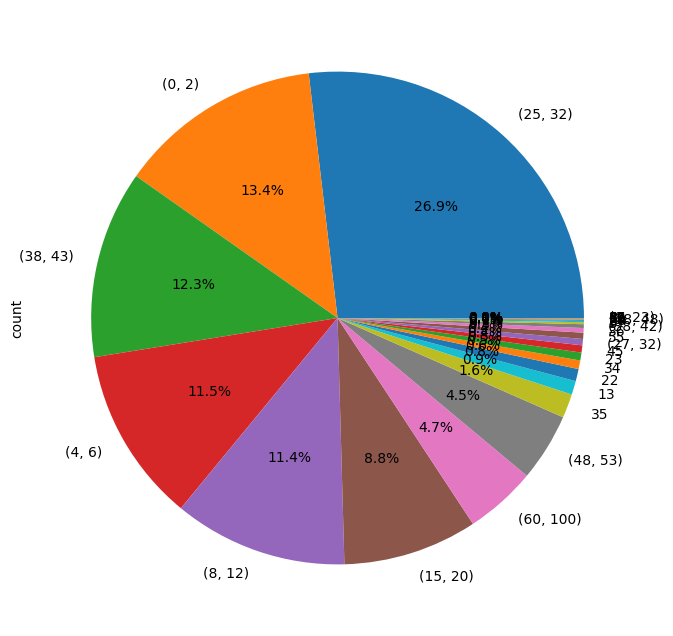

In [6]:
# pie_graph
plt.figure(1, figsize=(8,8))
total_data.age.value_counts().plot.pie(autopct="%1.1f%%")
plt.show()

gender
f    9372
m    8120
u    1099
Name: count, dtype: int64


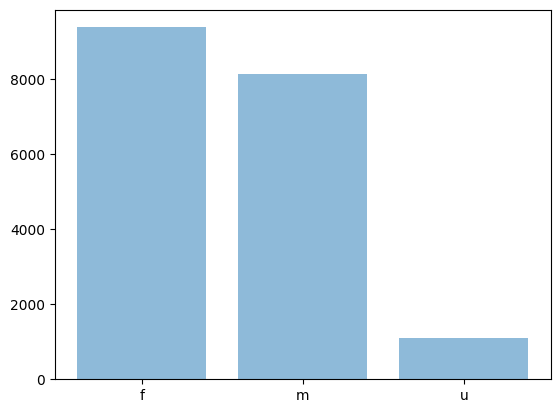

In [7]:
# bar chart
gender = ['f','m','u']
plt.bar(gender, total_data.gender.value_counts(), align='center', alpha=0.5)
print(total_data.gender.value_counts())
plt.show()

In [8]:
import os

# Create a copy of selected columns from total_data
df = total_data[['age', 'gender', 'x', 'y', 'dx', 'dy']].copy()

# Define the path to the faces directory
faces_path = "C:/Users/Kelly/Downloads/faces"

# Initialize a list to store the image paths
img_path = []

# Loop through each row of total_data and construct the corresponding image file path
for _, row in total_data.iterrows():
    # Build the path using os.path.join for proper path formatting
    path = os.path.join(
        faces_path,
        str(row.user_id),
        f"coarse_tilt_aligned_face.{row.face_id}.{row.original_image}"
    )
    img_path.append(path)

# Add the new image path column to the DataFrame
df['img_path'] = img_path

# Display concise summary information about the DataFrame
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19370 entries, 0 to 19369
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   age       18622 non-null  object
 1   gender    18591 non-null  object
 2   x         19370 non-null  int64 
 3   y         19370 non-null  int64 
 4   dx        19370 non-null  int64 
 5   dy        19370 non-null  int64 
 6   img_path  19370 non-null  object
dtypes: int64(4), object(3)
memory usage: 1.0+ MB


In [9]:
df.head()

,age,gender,x,y,dx,dy,img_path
0,"(25, 32)",f,0,414,1086,1383,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
1,"(25, 32)",m,301,105,640,641,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
2,"(25, 32)",f,2395,876,771,771,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
3,"(25, 32)",m,752,1255,484,485,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
4,"(25, 32)",m,175,80,769,768,C:/Users/Kelly/Downloads/faces\30601258@N03\co...


In [10]:
age_mapping = [('(0, 2)', '0-2'), ('2', '0-2'), ('3', '0-2'), ('(4, 6)', '4-6'), ('(8, 12)', '8-13'), ('13', '8-13'), ('22', '15-20'), ('(8, 23)','15-20'), ('23', '25-32'), ('(15, 20)', '15-20'), ('(25, 32)', '25-32'), ('(27, 32)', '25-32'), ('32', '25-32'), ('34', '25-32'), ('29', '25-32'), ('(38, 42)', '38-43'), ('35', '38-43'), ('36', '38-43'), ('42', '48-53'), ('45', '38-43'), ('(38, 43)', '38-43'), ('(38, 42)', '38-43'), ('(38, 48)', '48-53'), ('46', '48-53'), ('(48, 53)', '48-53'), ('55', '48-53'), ('56', '48-53'), ('(60, 100)', '60+'), ('57', '60+'), ('58', '60+')]

age_mapping_dict = {each[0]: each[1] for each in age_mapping}
drop_labels = []

for idx, each in enumerate(df.age):
    if each == 'None' or pd.isna(each):  # Check for both 'None' string and NaN values
        drop_labels.append(idx)
    else:
        try:
            df.age.loc[idx] = age_mapping_dict[each]
        except KeyError:
            print(f"Value not found in mapping: {each}")
            drop_labels.append(idx)

df = df.drop(labels=drop_labels, axis=0)  # Drop rows with None or unmapped values
df.age.value_counts(dropna=False)

C:\Users\Kelly\AppData\Local\Temp\ipykernel_16012\3802646260.py:11: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df.age.loc[idx] = age_mapping_dict[each]
C:\Users\Kelly\AppData\Local\Temp\ipykernel_16012\3802646260.py:11: SettingWithCopyWar

age
25-32    5296
38-43    2776
0-2      2509
8-13     2292
4-6      2140
15-20    1792
48-53     916
60+       901
Name: count, dtype: int64

In [11]:
df = df.dropna()
unbiased_data = df[df.gender != 'u'].copy()
unbiased_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 17452 entries, 0 to 19345
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   age       17452 non-null  object
 1   gender    17452 non-null  object
 2   x         17452 non-null  int64 
 3   y         17452 non-null  int64 
 4   dx        17452 non-null  int64 
 5   dy        17452 non-null  int64 
 6   img_path  17452 non-null  object
dtypes: int64(4), object(3)
memory usage: 1.1+ MB


In [12]:
unbiased_data['gender'].unique()
unbiased_data['gender'].value_counts()

gender
f    9332
m    8120
Name: count, dtype: int64

In [13]:
gender_to_label_map = {
    'f' : 0,
    'm' : 1
}

age_to_label_map = {
    '0-2'  :0,
    '4-6'  :1,
    '8-13' :2,
    '15-20':3,
    '25-32':4,
    '38-43':5,
    '48-53':6,
    '60+'  :7
}

# label_to_age_map = {value: key for key, value in age_to_label_map.items()}
# label_to_gender_map = {value: key for key, value in gender_to_label_map.items()}

unbiased_data['age'] = unbiased_data['age'].apply(lambda age: age_to_label_map[age])
unbiased_data['gender'] = unbiased_data['gender'].apply(lambda g: gender_to_label_map[g])

unbiased_data.head()

,age,gender,x,y,dx,dy,img_path
0,4,0,0,414,1086,1383,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
1,4,1,301,105,640,641,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
2,4,0,2395,876,771,771,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
3,4,1,752,1255,484,485,C:/Users/Kelly/Downloads/faces\30601258@N03\co...
4,4,1,175,80,769,768,C:/Users/Kelly/Downloads/faces\30601258@N03\co...


In [14]:
# Replace all backslashes with forward slashes in the img_path column
unbiased_data['img_path'] = unbiased_data['img_path'].str.replace('\\', '/', regex=False)

unbiased_data.head()

,age,gender,x,y,dx,dy,img_path
0,4,0,0,414,1086,1383,C:/Users/Kelly/Downloads/faces/30601258@N03/co...
1,4,1,301,105,640,641,C:/Users/Kelly/Downloads/faces/30601258@N03/co...
2,4,0,2395,876,771,771,C:/Users/Kelly/Downloads/faces/30601258@N03/co...
3,4,1,752,1255,484,485,C:/Users/Kelly/Downloads/faces/30601258@N03/co...
4,4,1,175,80,769,768,C:/Users/Kelly/Downloads/faces/30601258@N03/co...


In [15]:
# Replace the path prefix to include the 'faces' directory
unbiased_data['img_path'] = unbiased_data['img_path'].str.replace('C:/Users/Kelly/Downloads/faces/', 'C:/Users/Kelly/Downloads/faces/faces/', regex=False)

unbiased_data.head()

,age,gender,x,y,dx,dy,img_path
0,4,0,0,414,1086,1383,C:/Users/Kelly/Downloads/faces/faces/30601258@...
1,4,1,301,105,640,641,C:/Users/Kelly/Downloads/faces/faces/30601258@...
2,4,0,2395,876,771,771,C:/Users/Kelly/Downloads/faces/faces/30601258@...
3,4,1,752,1255,484,485,C:/Users/Kelly/Downloads/faces/faces/30601258@...
4,4,1,175,80,769,768,C:/Users/Kelly/Downloads/faces/faces/30601258@...


In [16]:
# Print all unique values for gender
print("\nUnique gender values:")
print(unbiased_data['gender'].unique())

# Print all unique values for age
print("\nUnique age values:")
print(unbiased_data['age'].unique())


Unique gender values:
[0 1]

Unique age values:
[4 5 1 7 3 6 2 0]


In [17]:
# Count by gender (0 = female, 1 = male)
gender_counts = unbiased_data['gender'].value_counts()
print("\nGender distribution:")
print(gender_counts)

# Count by age group
age_counts = unbiased_data['age'].value_counts().sort_index()
print("\nAge group distribution:")
print(age_counts)


Gender distribution:
gender
0    9332
1    8120
Name: count, dtype: int64

Age group distribution:
age
0    1418
1    2139
2    2285
3    1790
4    5240
5    2776
6     909
7     895
Name: count, dtype: int64


In [18]:
# Option 1: Using len()
row_count = len(unbiased_data)
print(f"Number of rows in unbiased_data: {row_count}")

# Option 2: Using shape attribute
row_count = unbiased_data.shape[0]  # shape returns (rows, columns)
print(f"Number of rows in unbiased_data: {row_count}")

Number of rows in unbiased_data: 17452
Number of rows in unbiased_data: 17452


Create Dataset

Gender classification 

In [19]:
# First, check how many NaN values exist in the gender column
print(f"Original unbiased_data shape: {unbiased_data.shape}")
nan_count = unbiased_data['gender'].isna().sum()
print(f"Number of NaN values in gender column: {nan_count}")

# Drop rows with NaN values directly in unbiased_data
unbiased_data = unbiased_data.dropna(subset=['gender'])
print(f"unbiased_data shape after dropping NaNs: {unbiased_data.shape}")

# Now create X and y from the cleaned unbiased_data
X = unbiased_data[['img_path']]
y = unbiased_data[['gender']]

# Verify no NaNs remain
print(f"NaN values in X: {X.isna().sum().sum()}")
print(f"NaN values in y: {y.isna().sum().sum()}")

Original unbiased_data shape: (17452, 7)
Number of NaN values in gender column: 0
unbiased_data shape after dropping NaNs: (17452, 7)
NaN values in X: 0
NaN values in y: 0


In [20]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from sklearn.model_selection import train_test_split
import pandas as pd

# 1️⃣ Transforms
train_transform = transforms.Compose([
    transforms.Resize((227,227)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.RandomResizedCrop((227,227), scale=(0.8,1.0)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

val_test_transform = transforms.Compose([
    transforms.Resize((227,227)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

class AdienceDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        # Use the full path directly from img_path column
        img_path = row["img_path"]
        try:
            img = Image.open(img_path).convert("RGB")
            
            if self.transform:
                img = self.transform(img)
            
            # Make sure the label is a float, not a numpy array or other type
            # that might cause conversion issues
            label = float(row["gender"])
            
            # Explicitly create a torch tensor (not from a numpy array)
            label_tensor = torch.tensor(label, dtype=torch.float32)
            
            # Verify the label is not NaN
            if torch.isnan(label_tensor):
                print(f"NaN detected in label at index {idx}, row: {row}")
                # Use 0.0 as a fallback
                label_tensor = torch.tensor(0.0, dtype=torch.float32)
                
            return img, label_tensor
            
        except Exception as e:
            print(f"Error loading item {idx}: {str(e)}")
            # Create a dummy image and label if loading fails
            dummy_img = torch.zeros((3, 227, 227), dtype=torch.float32)
            dummy_label = torch.tensor(0.0, dtype=torch.float32)
            return dummy_img, dummy_label

# Verify no NaNs in the original data
print("NaNs in unbiased_data gender column:", unbiased_data['gender'].isna().sum())

# Starting with X and y
X = unbiased_data[['img_path']]
y = unbiased_data[['gender']]

# Create train, validation, and test splits with 80/10/10 ratio
# First split into train and test+val (80/20)
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# Then split test+val into separate test and validation sets (50/50 of the 20%)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp
)  # This gives 10% validation, 10% test

# FIXED: Better way to combine features and targets while preserving indices
# Instead of using reset_index which can cause misalignment, we'll use the index-preserving concat
train_data = pd.concat([X_train, y_train], axis=1)
val_data = pd.concat([X_val, y_val], axis=1) 
test_data = pd.concat([X_test, y_test], axis=1)

# Check for any NaNs after combining
print("NaNs in train_data gender column:", train_data['gender'].isna().sum())
print("NaNs in val_data gender column:", val_data['gender'].isna().sum())
print("NaNs in test_data gender column:", test_data['gender'].isna().sum())

# Drop any rows with NaN values to be safe
train_data = train_data.dropna()
val_data = val_data.dropna()
test_data = test_data.dropna()

print(f"Dataset split: Train: {len(train_data)} (80%), Validation: {len(val_data)} (10%), Test: {len(test_data)} (10%)")

# 3️⃣ Instantiate DataLoaders
train_ds = AdienceDataset(train_data, transform=train_transform)
val_ds = AdienceDataset(val_data, transform=val_test_transform)
test_ds = AdienceDataset(test_data, transform=val_test_transform)

# Use num_workers and pin_memory for GPU acceleration if available
num_workers = 4 if torch.cuda.is_available() else 0
pin_memory = torch.cuda.is_available()

train_loader = DataLoader(train_ds, batch_size=32, shuffle=True)
            
val_loader = DataLoader(val_ds, batch_size=32, shuffle=False)
test_loader = DataLoader(test_ds, batch_size=32, shuffle=False)

# 4️⃣ Sanity check
try:
    images, labels = next(iter(train_loader))
    print("Train batch shapes → images:", images.shape, ", labels:", labels.shape)
    print(f"Label sample: {labels[:5]}")
    
    # Additional check for NaN values in the batch
    nan_count = torch.isnan(labels).sum().item()
    print(f"NaN values in batch: {nan_count}")
except Exception as e:
    print(f"Error during sanity check: {str(e)}")

NaNs in unbiased_data gender column: 0
NaNs in train_data gender column: 0
NaNs in val_data gender column: 0
NaNs in test_data gender column: 0
Dataset split: Train: 13961 (80%), Validation: 1745 (10%), Test: 1746 (10%)
Train batch shapes → images: torch.Size([32, 3, 227, 227]) , labels: torch.Size([32])
Label sample: tensor([1., 0., 1., 0., 0.])
NaN values in batch: 0


Age classification 

In [24]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from sklearn.model_selection import train_test_split
import pandas as pd

# 1️⃣ Transforms
train_transform = transforms.Compose([
    transforms.Resize((227,227)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.RandomResizedCrop((227,227), scale=(0.8,1.0)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

val_test_transform = transforms.Compose([
    transforms.Resize((227,227)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

class AdienceAgeDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        # Use the full path directly from img_path column
        img_path = row["img_path"]
        try:
            img = Image.open(img_path).convert("RGB")
            
            if self.transform:
                img = self.transform(img)
            
            # For age classification, labels should be integers (0-7)
            age_label = int(row["age"])
            
            # Explicitly create a torch tensor for age (use long for classification)
            age_tensor = torch.tensor(age_label, dtype=torch.long)
            
            # Verify the label is not invalid
            if age_label < 0 or age_label > 7:
                print(f"Invalid age label at index {idx}, row: {row}")
                # Use 0 as a fallback for invalid labels
                age_tensor = torch.tensor(0, dtype=torch.long)
                
            return img, age_tensor
            
        except Exception as e:
            print(f"Error loading item {idx}: {str(e)}")
            # Create a dummy image and label if loading fails
            dummy_img = torch.zeros((3, 227, 227), dtype=torch.float32)
            dummy_label = torch.tensor(0, dtype=torch.long)
            return dummy_img, dummy_label


# Now create X_age and y_age from the cleaned data
X_age = unbiased_data[['img_path']]
y_age = unbiased_data[['age']]

# Verify no NaNs remain
print(f"NaN values in X_age: {X_age.isna().sum().sum()}")
print(f"NaN values in y_age: {y_age.isna().sum().sum()}")

# Create train, validation, and test splits with 80/10/10 ratio
# First split into train and test+val (80/20)
X_age_train, X_age_temp, y_age_train, y_age_temp = train_test_split(
    X_age, y_age, test_size=0.2, random_state=42, stratify=y_age
)

# Then split test+val into separate test and validation sets (50/50 of the 20%)
X_age_val, X_age_test, y_age_val, y_age_test = train_test_split(
    X_age_temp, y_age_temp, test_size=0.5, random_state=42, stratify=y_age_temp
)  # This gives 10% validation, 10% test

# Combine features and targets while preserving indices
train_age_data = pd.concat([X_age_train, y_age_train], axis=1)
val_age_data = pd.concat([X_age_val, y_age_val], axis=1) 
test_age_data = pd.concat([X_age_test, y_age_test], axis=1)

# Check for any NaNs after combining
print("NaNs in train_age_data age column:", train_age_data['age'].isna().sum())
print("NaNs in val_age_data age column:", val_age_data['age'].isna().sum())
print("NaNs in test_age_data age column:", test_age_data['age'].isna().sum())

# Drop any rows with NaN values to be safe
train_age_data = train_age_data.dropna()
val_age_data = val_age_data.dropna()
test_age_data = test_age_data.dropna()

print(f"Age dataset split: Train: {len(train_age_data)} (80%), Validation: {len(val_age_data)} (10%), Test: {len(test_age_data)} (10%)")

# Examine the distribution of age classes in each set
print("\nAge distribution in training set:")
print(train_age_data['age'].value_counts().sort_index())
print("\nAge distribution in validation set:")
print(val_age_data['age'].value_counts().sort_index())
print("\nAge distribution in test set:")
print(test_age_data['age'].value_counts().sort_index())

# 3️⃣ Instantiate DataLoaders for age classification
train_age_ds = AdienceAgeDataset(train_age_data, transform=train_transform)
val_age_ds = AdienceAgeDataset(val_age_data, transform=val_test_transform)
test_age_ds = AdienceAgeDataset(test_age_data, transform=val_test_transform)

# Use num_workers and pin_memory for GPU acceleration if available
num_workers = 4 if torch.cuda.is_available() else 0
pin_memory = torch.cuda.is_available()

train_age_loader = DataLoader(train_age_ds, batch_size=32, shuffle=True)
val_age_loader = DataLoader(val_age_ds, batch_size=32, shuffle=False)
test_age_loader = DataLoader(test_age_ds, batch_size=32, shuffle=False)

# 4️⃣ Sanity check
try:
    images, age_labels = next(iter(train_age_loader))
    print("Train batch shapes → images:", images.shape, ", age_labels:", age_labels.shape)
    print(f"Age label sample: {age_labels[:5]}")
    
    # Check value ranges
    print(f"Age label min: {age_labels.min().item()}, max: {age_labels.max().item()}")
    print(f"Age label unique values: {torch.unique(age_labels).tolist()}")
except Exception as e:
    print(f"Error during sanity check: {str(e)}")

NaN values in X_age: 0
NaN values in y_age: 0
NaNs in train_age_data age column: 0
NaNs in val_age_data age column: 0
NaNs in test_age_data age column: 0
Age dataset split: Train: 13961 (80%), Validation: 1745 (10%), Test: 1746 (10%)

Age distribution in training set:
age
0    1134
1    1711
2    1828
3    1432
4    4192
5    2221
6     727
7     716
Name: count, dtype: int64

Age distribution in validation set:
age
0    142
1    214
2    228
3    179
4    524
5    277
6     91
7     90
Name: count, dtype: int64

Age distribution in test set:
age
0    142
1    214
2    229
3    179
4    524
5    278
6     91
7     89
Name: count, dtype: int64
Train batch shapes → images: torch.Size([32, 3, 227, 227]) , age_labels: torch.Size([32])
Age label sample: tensor([2, 4, 2, 4, 1])
Age label min: 1, max: 7
Age label unique values: [1, 2, 3, 4, 5, 6, 7]


Create Model 

In [21]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.models import inception_v3, Inception_V3_Weights
import matplotlib.pyplot as plt
import random
import numpy as np

# Enable better CUDA error reporting
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

# Check CUDA details
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA version: {torch.version.cuda}")
    print(f"GPU device: {torch.cuda.get_device_name(0)}")
    print(f"GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")

# ───── DEVICE SETUP ─────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# ───── Wrapper to resize inputs and handle aux_logits ─────
class ResizeInception(nn.Module):
    def __init__(self, base):
        super().__init__()
        self.resize = nn.Upsample(size=(299,299), mode='bilinear', align_corners=False)
        self.base = base

    def forward(self, x):
        x = self.resize(x)
        # Correctly handle auxiliary outputs during training
        if self.training and self.base.aux_logits:
            outputs, _ = self.base(x)  # Discard the auxiliary output
            return outputs
        else:
            return self.base(x)

# ───── Load pretrained InceptionV3 ─────
try:
    base = inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1)
    print("Successfully loaded InceptionV3 with pretrained weights")
except Exception as e:
    print(f"Error loading InceptionV3: {str(e)}")
    # Try without pretrained weights
    base = inception_v3(weights=None)
    print("Loaded InceptionV3 without pretrained weights")

# ───── Replace classifier head ─────
in_features = base.fc.in_features
base.fc = nn.Sequential(
    nn.Linear(in_features, 1024),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(1024, 512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 1),
    nn.Sigmoid()
)

# ───── Wrap with resize module ─────
try:
    model = ResizeInception(base).to(device)
    print(f"Successfully created model on {device}")
except Exception as e:
    print(f"Error moving model to {device}: {str(e)}")
    print("Falling back to CPU")
    device = torch.device("cpu")
    model = ResizeInception(base).to(device)

# ───── Freeze first 52 parameters ─────
params = list(model.parameters())
for p in params[:52]:
    p.requires_grad = False

print("Trainable params:", sum(p.numel() for p in model.parameters() if p.requires_grad))

# ───── Optimizer + Loss ─────
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
criterion = nn.BCELoss()

# ─── SET REPRODUCIBILITY ───────────────────────────────────────────────────────────
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
if torch.cuda.is_available():
    try:
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    except Exception as e:
        print(f"Warning: Could not set CUDA seeds: {str(e)}")

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# ─── TRAINING + EARLY STOPPING ─────────────────────────────────────────────────────
history = {
    "train_loss": [], "train_acc": [],
    "val_loss": [],   "val_acc": [],
    "test_loss": [],  "test_acc": []
}

best_val_acc = 0.0
patience = 5
epochs_no_improve = 0
best_path = "C:/Users/Kelly/Downloads/SC4001/weights/inception_gender.pth"

print("Starting training...")

for epoch in range(1, 51):
    # ---------- TRAIN ----------
    model.train()
    running_loss = correct = total = 0
    
    try:
        for batch_idx, (imgs, labels) in enumerate(train_loader):
            try:
                # Ensure proper data types and device
                imgs = imgs.to(device)
                labels = labels.float().to(device)
                
                # Print first batch info in first epoch
                if epoch == 1 and batch_idx == 0:
                    print(f"Train batch - imgs: {imgs.shape}, labels: {labels.shape}")
                
                optimizer.zero_grad()
                outputs = model(imgs).squeeze()
                loss = criterion(outputs, labels)
                loss.backward()
                optimizer.step()

                running_loss += loss.item() * imgs.size(0)
                preds = (outputs>0.5).float()
                correct += (preds==labels).sum().item()
                total += labels.size(0)
                
            except Exception as e:
                print(f"Error in train batch {batch_idx}: {str(e)}")
                continue

        train_loss = running_loss/total if total > 0 else float('nan')
        train_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in training phase: {str(e)}")
        train_loss = float('nan')
        train_acc = float('nan')

    # ---------- VALIDATION ----------
    model.eval()
    running_loss = correct = total = 0
    
    try:
        with torch.no_grad():
            for batch_idx, (imgs, labels) in enumerate(val_loader):
                try:
                    imgs = imgs.to(device)
                    labels = labels.float().to(device)
                    
                    outputs = model(imgs).squeeze()
                    loss = criterion(outputs, labels)

                    running_loss += loss.item() * imgs.size(0)
                    preds = (outputs>0.5).float()
                    correct += (preds==labels).sum().item()
                    total += labels.size(0)
                    
                except Exception as e:
                    print(f"Error in validation batch {batch_idx}: {str(e)}")
                    continue

        val_loss = running_loss/total if total > 0 else float('nan')
        val_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in validation phase: {str(e)}")
        val_loss = float('nan')
        val_acc = float('nan')

    # ---------- TEST ----------
    running_loss = correct = total = 0
    
    try:
        with torch.no_grad():
            for batch_idx, (imgs, labels) in enumerate(test_loader):
                try:
                    imgs = imgs.to(device)
                    labels = labels.float().to(device)
                    
                    outputs = model(imgs).squeeze()
                    loss = criterion(outputs, labels)

                    running_loss += loss.item() * imgs.size(0)
                    preds = (outputs>0.5).float()
                    correct += (preds==labels).sum().item()
                    total += labels.size(0)
                    
                except Exception as e:
                    print(f"Error in test batch {batch_idx}: {str(e)}")
                    continue

        test_loss = running_loss/total if total > 0 else float('nan')
        test_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in test phase: {str(e)}")
        test_loss = float('nan')
        test_acc = float('nan')

    # Store history
    history["train_loss"].append(train_loss)
    history["train_acc"].append(train_acc)
    history["val_loss"].append(val_loss)
    history["val_acc"].append(val_acc)
    history["test_loss"].append(test_loss)
    history["test_acc"].append(test_acc)

    print(f"Epoch {epoch} ▶ train_loss={train_loss:.4f}, train_acc={train_acc:.4f} | "
          f"val_loss={val_loss:.4f}, val_acc={val_acc:.4f} | "
          f"test_loss={test_loss:.4f}, test_acc={test_acc:.4f}")

    # Checkpoint & EarlyStopping
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        try:
            torch.save(model.state_dict(), best_path)
            print("✅ Saved best model")
        except Exception as e:
            print(f"Error saving model: {str(e)}")
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            print(f"🛑 Early stopping at epoch {epoch}")
            break

print(f"Best validation accuracy: {best_val_acc:.4f}")

# Plotting code for visualization
def plot_history():
    epochs = range(1, len(history["train_loss"]) + 1)
    plt.figure(figsize=(14, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history["train_loss"], label="Train Loss")
    plt.plot(epochs, history["val_loss"], label="Validation Loss")
    plt.plot(epochs, history["test_loss"], label="Test Loss")
    plt.title("Loss vs Epoch")
    plt.xlabel("Epoch"); plt.ylabel("Loss"); plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history["train_acc"], label="Train Accuracy")
    plt.plot(epochs, history["val_acc"], label="Validation Accuracy")
    plt.plot(epochs, history["test_acc"], label="Test Accuracy")
    plt.title("Accuracy vs Epoch")
    plt.xlabel("Epoch"); plt.ylabel("Accuracy"); plt.legend()
    
    plt.tight_layout()
    plt.savefig("C:/Users/Kelly/Downloads/SC4001/weights/training_history.png")
    plt.show()

# After training, call this to visualize results
plot_history()

CUDA available: True
CUDA version: 12.1
GPU device: NVIDIA GeForce RTX 4060 Laptop GPU
GPU memory: 8.59 GB
Using device: cuda
Successfully loaded InceptionV3 with pretrained weights
Successfully created model on cuda
Trainable params: 27046409
Starting training...
Train batch - imgs: torch.Size([32, 3, 227, 227]), labels: torch.Size([32])
Epoch 1 ▶ train_loss=0.2827, train_acc=0.8676 | val_loss=0.1331, val_acc=0.9542 | test_loss=0.1309, test_acc=0.9490
✅ Saved best model
Epoch 2 ▶ train_loss=0.1276, train_acc=0.9504 | val_loss=0.0938, val_acc=0.9673 | test_loss=0.1097, test_acc=0.9582
✅ Saved best model
Epoch 3 ▶ train_loss=0.0773, train_acc=0.9731 | val_loss=0.1176, val_acc=0.9576 | test_loss=0.1134, test_acc=0.9582
Epoch 4 ▶ train_loss=0.0651, train_acc=0.9760 | val_loss=0.1158, val_acc=0.9570 | test_loss=0.1115, test_acc=0.9611
Epoch 5 ▶ train_loss=0.0493, train_acc=0.9828 | val_loss=0.0780, val_acc=0.9725 | test_loss=0.0983, test_acc=0.9685
✅ Saved best model
Epoch 6 ▶ train_loss=0

KeyboardInterrupt: 

Gender Classification InceptionNet on Adience

CUDA available: True
CUDA version: 12.1
GPU device: NVIDIA GeForce RTX 4060 Laptop GPU
GPU memory: 8.59 GB
Using device: cuda


c:\Users\Kelly\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\inception.py:43: FutureWarning: The default weight initialization of inception_v3 will be changed in future releases of torchvision. If you wish to keep the old behavior (which leads to long initialization times due to scipy/scipy#11299), please set init_weights=True.
  warnings.warn(


Successfully loaded InceptionV3 architecture
Successfully created model on cuda


C:\Users\Kelly\AppData\Local\Temp\ipykernel_16012\3113662458.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(pretrained_path, map_location=devic

Successfully loaded pretrained weights from C:/Users/Kelly/Downloads/SC4001/weights/inception_gender.pth
Trainable params: 27046409
Starting training on Adience dataset...
Train batch - imgs: torch.Size([32, 3, 227, 227]), labels: torch.Size([32])
Epoch 1 ▶ train_loss=0.0135, train_acc=0.9957 | val_loss=0.1469, val_acc=0.9759 | test_loss=0.1565, test_acc=0.9679
✅ Saved best model
Epoch 2 ▶ train_loss=0.0088, train_acc=0.9969 | val_loss=0.0748, val_acc=0.9822 | test_loss=0.1336, test_acc=0.9714
✅ Saved best model
Epoch 3 ▶ train_loss=0.0085, train_acc=0.9971 | val_loss=0.1218, val_acc=0.9799 | test_loss=0.1320, test_acc=0.9731
Epoch 4 ▶ train_loss=0.0071, train_acc=0.9974 | val_loss=0.0790, val_acc=0.9788 | test_loss=0.2233, test_acc=0.9685
Epoch 5 ▶ train_loss=0.0101, train_acc=0.9966 | val_loss=0.0634, val_acc=0.9840 | test_loss=0.1096, test_acc=0.9754
✅ Saved best model
Epoch 6 ▶ train_loss=0.0080, train_acc=0.9977 | val_loss=0.0913, val_acc=0.9782 | test_loss=0.1162, test_acc=0.9742

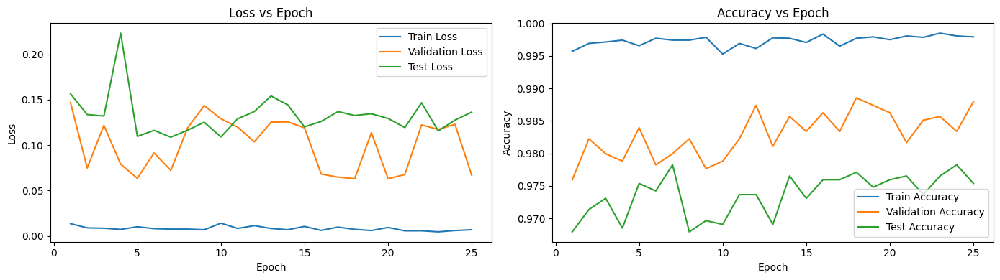

In [22]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.models import inception_v3
import matplotlib.pyplot as plt
import random
import numpy as np

# Enable better CUDA error reporting
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

# Check CUDA details
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA version: {torch.version.cuda}")
    print(f"GPU device: {torch.cuda.get_device_name(0)}")
    print(f"GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")

# ───── DEVICE SETUP ─────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# ───── Wrapper to resize inputs and handle aux_logits ─────
class ResizeInception(nn.Module):
    def __init__(self, base):
        super().__init__()
        self.resize = nn.Upsample(size=(299,299), mode='bilinear', align_corners=False)
        self.base = base

    def forward(self, x):
        x = self.resize(x)
        # Correctly handle auxiliary outputs during training
        if self.training and self.base.aux_logits:
            outputs, _ = self.base(x)  # Discard the auxiliary output
            return outputs
        else:
            return self.base(x)

# ───── Load InceptionV3 architecture (without pretrained weights) ─────
try:
    base = inception_v3(weights=None)
    print("Successfully loaded InceptionV3 architecture")
except Exception as e:
    print(f"Error loading InceptionV3: {str(e)}")
    raise e  # Critical error, can't continue

# ───── Replace classifier head with the same architecture as the pretrained model ─────
in_features = base.fc.in_features
base.fc = nn.Sequential(
    nn.Linear(in_features, 1024),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(1024, 512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 1),
    nn.Sigmoid()
)

# ───── Wrap with resize module ─────
try:
    model = ResizeInception(base).to(device)
    print(f"Successfully created model on {device}")
except Exception as e:
    print(f"Error moving model to {device}: {str(e)}")
    print("Falling back to CPU")
    device = torch.device("cpu")
    model = ResizeInception(base).to(device)

# ───── Load the pretrained weights from CelebA ─────
pretrained_path = "C:/Users/Kelly/Downloads/SC4001/weights/inception_gender.pth"

try:
    # Check if the file exists
    if not os.path.exists(pretrained_path):
        raise FileNotFoundError(f"Pretrained model file not found at {pretrained_path}")
    
    # Load the weights
    state_dict = torch.load(pretrained_path, map_location=device)
    model.load_state_dict(state_dict)
    print(f"Successfully loaded pretrained weights from {pretrained_path}")
except Exception as e:
    print(f"Error loading pretrained weights: {str(e)}")
    print("Will continue with randomly initialized weights")

# ───── Choose transfer learning strategy ─────
# Option 1: Fine-tune only the classifier (freeze feature extraction layers)
params = list(model.parameters())
for p in params[:52]:  # Freeze the first 52 parameters (feature extraction)
    p.requires_grad = False

# Option 2: Fine-tune the whole model
# Uncomment below to fine-tune all parameters
# for p in model.parameters():
#     p.requires_grad = True

print("Trainable params:", sum(p.numel() for p in model.parameters() if p.requires_grad))

# ───── Optimizer + Loss ─────
# Lower learning rate for transfer learning
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=5e-5)
criterion = nn.BCELoss()

# ─── SET REPRODUCIBILITY ───────────────────────────────────────────────────────────
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
if torch.cuda.is_available():
    try:
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    except Exception as e:
        print(f"Warning: Could not set CUDA seeds: {str(e)}")

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# ─── TRAINING + EARLY STOPPING ─────────────────────────────────────────────────────
history = {
    "train_loss": [], "train_acc": [],
    "val_loss": [],   "val_acc": [],
    "test_loss": [],  "test_acc": []
}

best_val_acc = 0.0
patience = 7  # Increased patience for transfer learning
epochs_no_improve = 0
best_path = "C:/Users/Kelly/Downloads/SC4001/weights/inception_gender_adience.pth"

print("Starting training on Adience dataset...")

for epoch in range(1, 31):  # Fewer epochs since we're starting with pretrained weights
    # ---------- TRAIN ----------
    model.train()
    running_loss = correct = total = 0
    
    try:
        for batch_idx, (imgs, labels) in enumerate(train_loader):
            try:
                # Ensure proper data types and device
                imgs = imgs.to(device)
                labels = labels.float().to(device)
                
                # Print first batch info in first epoch
                if epoch == 1 and batch_idx == 0:
                    print(f"Train batch - imgs: {imgs.shape}, labels: {labels.shape}")
                
                optimizer.zero_grad()
                outputs = model(imgs).squeeze()
                loss = criterion(outputs, labels)
                loss.backward()
                optimizer.step()

                running_loss += loss.item() * imgs.size(0)
                preds = (outputs>0.5).float()
                correct += (preds==labels).sum().item()
                total += labels.size(0)
                
            except Exception as e:
                print(f"Error in train batch {batch_idx}: {str(e)}")
                continue

        train_loss = running_loss/total if total > 0 else float('nan')
        train_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in training phase: {str(e)}")
        train_loss = float('nan')
        train_acc = float('nan')

    # ---------- VALIDATION ----------
    model.eval()
    running_loss = correct = total = 0
    
    try:
        with torch.no_grad():
            for batch_idx, (imgs, labels) in enumerate(val_loader):
                try:
                    imgs = imgs.to(device)
                    labels = labels.float().to(device)
                    
                    outputs = model(imgs).squeeze()
                    loss = criterion(outputs, labels)

                    running_loss += loss.item() * imgs.size(0)
                    preds = (outputs>0.5).float()
                    correct += (preds==labels).sum().item()
                    total += labels.size(0)
                    
                except Exception as e:
                    print(f"Error in validation batch {batch_idx}: {str(e)}")
                    continue

        val_loss = running_loss/total if total > 0 else float('nan')
        val_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in validation phase: {str(e)}")
        val_loss = float('nan')
        val_acc = float('nan')

    # ---------- TEST ----------
    running_loss = correct = total = 0
    
    try:
        with torch.no_grad():
            for batch_idx, (imgs, labels) in enumerate(test_loader):
                try:
                    imgs = imgs.to(device)
                    labels = labels.float().to(device)
                    
                    outputs = model(imgs).squeeze()
                    loss = criterion(outputs, labels)

                    running_loss += loss.item() * imgs.size(0)
                    preds = (outputs>0.5).float()
                    correct += (preds==labels).sum().item()
                    total += labels.size(0)
                    
                except Exception as e:
                    print(f"Error in test batch {batch_idx}: {str(e)}")
                    continue

        test_loss = running_loss/total if total > 0 else float('nan')
        test_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in test phase: {str(e)}")
        test_loss = float('nan')
        test_acc = float('nan')

    # Store history
    history["train_loss"].append(train_loss)
    history["train_acc"].append(train_acc)
    history["val_loss"].append(val_loss)
    history["val_acc"].append(val_acc)
    history["test_loss"].append(test_loss)
    history["test_acc"].append(test_acc)

    print(f"Epoch {epoch} ▶ train_loss={train_loss:.4f}, train_acc={train_acc:.4f} | "
          f"val_loss={val_loss:.4f}, val_acc={val_acc:.4f} | "
          f"test_loss={test_loss:.4f}, test_acc={test_acc:.4f}")

    # Checkpoint & EarlyStopping
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        try:
            torch.save(model.state_dict(), best_path)
            print("✅ Saved best model")
        except Exception as e:
            print(f"Error saving model: {str(e)}")
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            print(f"🛑 Early stopping at epoch {epoch}")
            break

print(f"Best validation accuracy: {best_val_acc:.4f}")

# Plotting code for visualization
def plot_history():
    epochs = range(1, len(history["train_loss"]) + 1)
    plt.figure(figsize=(14, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history["train_loss"], label="Train Loss")
    plt.plot(epochs, history["val_loss"], label="Validation Loss")
    plt.plot(epochs, history["test_loss"], label="Test Loss")
    plt.title("Loss vs Epoch")
    plt.xlabel("Epoch"); plt.ylabel("Loss"); plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history["train_acc"], label="Train Accuracy")
    plt.plot(epochs, history["val_acc"], label="Validation Accuracy")
    plt.plot(epochs, history["test_acc"], label="Test Accuracy")
    plt.title("Accuracy vs Epoch")
    plt.xlabel("Epoch"); plt.ylabel("Accuracy"); plt.legend()
    
    plt.tight_layout()
    plt.savefig("C:/Users/Kelly/Downloads/SC4001/weights/adience_training_history.png")
    plt.show()

# After training, call this to visualize results
plot_history()

Age classification using InceptionNet on Adience 

CUDA available: True
CUDA version: 12.1
GPU device: NVIDIA GeForce RTX 4060 Laptop GPU
GPU memory: 8.59 GB
Using device: cuda


c:\Users\Kelly\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\inception.py:43: FutureWarning: The default weight initialization of inception_v3 will be changed in future releases of torchvision. If you wish to keep the old behavior (which leads to long initialization times due to scipy/scipy#11299), please set init_weights=True.
  warnings.warn(


Successfully loaded InceptionV3 architecture
Successfully created model on cuda


C:\Users\Kelly\AppData\Local\Temp\ipykernel_16012\417645206.py:81: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  pretrained_dict = torch.load(pretrained_path, map_location=d

Successfully loaded pretrained weights from C:/Users/Kelly/Downloads/SC4001/weights/inception_gender.pth (except final classification layer)
Trainable params: 27050000
Starting training on Adience dataset for age classification...
Train batch - imgs: torch.Size([32, 3, 227, 227]), age_labels: torch.Size([32])
Age labels sample: tensor([4, 0, 1, 2, 1], device='cuda:0')
Epoch 1 ▶ train_loss=1.6796, train_acc=0.3522 | val_loss=1.1297, val_acc=0.5330 | test_loss=1.1293, test_acc=0.5315
✅ Saved best model
Epoch 2 ▶ train_loss=1.0193, train_acc=0.5934 | val_loss=0.8007, val_acc=0.6831 | test_loss=0.7618, test_acc=0.6959
✅ Saved best model
Epoch 3 ▶ train_loss=0.7394, train_acc=0.7150 | val_loss=0.7067, val_acc=0.7261 | test_loss=0.6784, test_acc=0.7371
✅ Saved best model
Epoch 4 ▶ train_loss=0.6028, train_acc=0.7721 | val_loss=0.6336, val_acc=0.7639 | test_loss=0.5932, test_acc=0.7709
✅ Saved best model
Epoch 5 ▶ train_loss=0.4780, train_acc=0.8252 | val_loss=0.6040, val_acc=0.7805 | test_lo

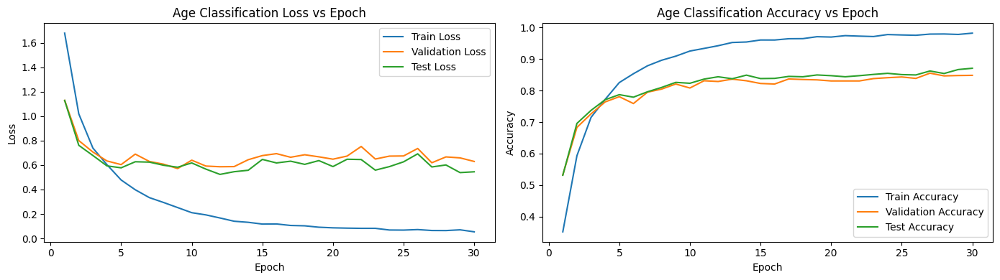

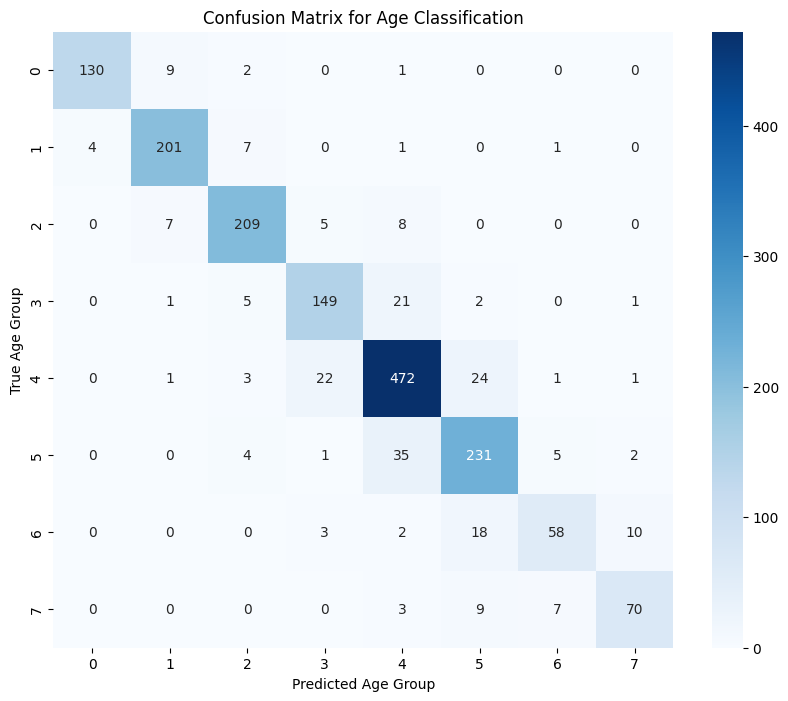

In [25]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.models import inception_v3
import matplotlib.pyplot as plt
import random
import numpy as np

# Enable better CUDA error reporting
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

# Check CUDA details
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA version: {torch.version.cuda}")
    print(f"GPU device: {torch.cuda.get_device_name(0)}")
    print(f"GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")

# ───── DEVICE SETUP ─────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# ───── Wrapper to resize inputs and handle aux_logits ─────
class ResizeInception(nn.Module):
    def __init__(self, base):
        super().__init__()
        self.resize = nn.Upsample(size=(299,299), mode='bilinear', align_corners=False)
        self.base = base

    def forward(self, x):
        x = self.resize(x)
        # Correctly handle auxiliary outputs during training
        if self.training and self.base.aux_logits:
            outputs, _ = self.base(x)  # Discard the auxiliary output
            return outputs
        else:
            return self.base(x)

# ───── Load InceptionV3 architecture (without pretrained weights) ─────
try:
    base = inception_v3(weights=None)
    print("Successfully loaded InceptionV3 architecture")
except Exception as e:
    print(f"Error loading InceptionV3: {str(e)}")
    raise e  # Critical error, can't continue

# ───── Replace classifier head for age classification (8 classes) ─────
in_features = base.fc.in_features
base.fc = nn.Sequential(
    nn.Linear(in_features, 1024),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(1024, 512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 8),  # 8 output classes for age groups
    # No activation here since we'll use CrossEntropyLoss which includes softmax
)

# ───── Wrap with resize module ─────
try:
    age_model = ResizeInception(base).to(device)
    print(f"Successfully created model on {device}")
except Exception as e:
    print(f"Error moving model to {device}: {str(e)}")
    print("Falling back to CPU")
    device = torch.device("cpu")
    age_model = ResizeInception(base).to(device)

# ───── Load the pretrained weights from gender model and adapt for age classification ─────
# We'll load the gender pretrained weights but skip the final layer which has a different shape
pretrained_path = "C:/Users/Kelly/Downloads/SC4001/weights/inception_gender.pth"

try:
    # Check if the file exists
    if not os.path.exists(pretrained_path):
        raise FileNotFoundError(f"Pretrained model file not found at {pretrained_path}")
    
    # Load the weights
    pretrained_dict = torch.load(pretrained_path, map_location=device)
    
    # Create a filtered dictionary with weights that match our model
    model_dict = age_model.state_dict()
    filtered_dict = {k: v for k, v in pretrained_dict.items() if k in model_dict and 'fc.4' not in k and 'fc.6' not in k}
    
    # Update model with filtered weights
    model_dict.update(filtered_dict)
    age_model.load_state_dict(model_dict, strict=False)
    
    print(f"Successfully loaded pretrained weights from {pretrained_path} (except final classification layer)")
except Exception as e:
    print(f"Error loading pretrained weights: {str(e)}")
    print("Will continue with randomly initialized weights")

# ───── Choose transfer learning strategy ─────
# Option 1: Fine-tune only the classifier (freeze feature extraction layers)
params = list(age_model.parameters())
for p in params[:52]:  # Freeze the first 52 parameters (feature extraction)
    p.requires_grad = False

# Option 2: Fine-tune the whole model
# Uncomment below to fine-tune all parameters
# for p in age_model.parameters():
#     p.requires_grad = True

print("Trainable params:", sum(p.numel() for p in age_model.parameters() if p.requires_grad))

# ───── Optimizer + Loss ─────
# Lower learning rate for transfer learning
age_optimizer = optim.Adam(filter(lambda p: p.requires_grad, age_model.parameters()), lr=5e-5)
age_criterion = nn.CrossEntropyLoss()  # CrossEntropyLoss for multi-class classification

# ─── SET REPRODUCIBILITY ───────────────────────────────────────────────────────────
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
if torch.cuda.is_available():
    try:
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    except Exception as e:
        print(f"Warning: Could not set CUDA seeds: {str(e)}")

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# ─── TRAINING + EARLY STOPPING ─────────────────────────────────────────────────────
age_history = {
    "train_loss": [], "train_acc": [],
    "val_loss": [],   "val_acc": [],
    "test_loss": [],  "test_acc": []
}

best_val_acc = 0.0
patience = 7  # Increased patience for transfer learning
epochs_no_improve = 0
best_path = "C:/Users/Kelly/Downloads/SC4001/weights/inception_age_adience.pth"

print("Starting training on Adience dataset for age classification...")

for epoch in range(1, 31):  # Fewer epochs since we're starting with pretrained weights
    # ---------- TRAIN ----------
    age_model.train()
    running_loss = correct = total = 0
    
    try:
        for batch_idx, (imgs, age_labels) in enumerate(train_age_loader):
            try:
                # Ensure proper data types and device
                imgs = imgs.to(device)
                age_labels = age_labels.to(device)  # Already long type from dataset
                
                # Print first batch info in first epoch
                if epoch == 1 and batch_idx == 0:
                    print(f"Train batch - imgs: {imgs.shape}, age_labels: {age_labels.shape}")
                    print(f"Age labels sample: {age_labels[:5]}")
                
                age_optimizer.zero_grad()
                outputs = age_model(imgs)
                loss = age_criterion(outputs, age_labels)
                loss.backward()
                age_optimizer.step()

                running_loss += loss.item() * imgs.size(0)
                _, preds = torch.max(outputs, 1)
                correct += (preds == age_labels).sum().item()
                total += age_labels.size(0)
                
            except Exception as e:
                print(f"Error in train batch {batch_idx}: {str(e)}")
                continue

        train_loss = running_loss/total if total > 0 else float('nan')
        train_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in training phase: {str(e)}")
        train_loss = float('nan')
        train_acc = float('nan')

    # ---------- VALIDATION ----------
    age_model.eval()
    running_loss = correct = total = 0
    
    try:
        with torch.no_grad():
            for batch_idx, (imgs, age_labels) in enumerate(val_age_loader):
                try:
                    imgs = imgs.to(device)
                    age_labels = age_labels.to(device)
                    
                    outputs = age_model(imgs)
                    loss = age_criterion(outputs, age_labels)

                    running_loss += loss.item() * imgs.size(0)
                    _, preds = torch.max(outputs, 1)
                    correct += (preds == age_labels).sum().item()
                    total += age_labels.size(0)
                    
                except Exception as e:
                    print(f"Error in validation batch {batch_idx}: {str(e)}")
                    continue

        val_loss = running_loss/total if total > 0 else float('nan')
        val_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in validation phase: {str(e)}")
        val_loss = float('nan')
        val_acc = float('nan')

    # ---------- TEST ----------
    running_loss = correct = total = 0
    
    try:
        with torch.no_grad():
            for batch_idx, (imgs, age_labels) in enumerate(test_age_loader):
                try:
                    imgs = imgs.to(device)
                    age_labels = age_labels.to(device)
                    
                    outputs = age_model(imgs)
                    loss = age_criterion(outputs, age_labels)

                    running_loss += loss.item() * imgs.size(0)
                    _, preds = torch.max(outputs, 1)
                    correct += (preds == age_labels).sum().item()
                    total += age_labels.size(0)
                    
                except Exception as e:
                    print(f"Error in test batch {batch_idx}: {str(e)}")
                    continue

        test_loss = running_loss/total if total > 0 else float('nan')
        test_acc = correct/total if total > 0 else float('nan')
        
    except Exception as e:
        print(f"Error in test phase: {str(e)}")
        test_loss = float('nan')
        test_acc = float('nan')

    # Store history
    age_history["train_loss"].append(train_loss)
    age_history["train_acc"].append(train_acc)
    age_history["val_loss"].append(val_loss)
    age_history["val_acc"].append(val_acc)
    age_history["test_loss"].append(test_loss)
    age_history["test_acc"].append(test_acc)

    print(f"Epoch {epoch} ▶ train_loss={train_loss:.4f}, train_acc={train_acc:.4f} | "
          f"val_loss={val_loss:.4f}, val_acc={val_acc:.4f} | "
          f"test_loss={test_loss:.4f}, test_acc={test_acc:.4f}")

    # Checkpoint & EarlyStopping
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        try:
            torch.save(age_model.state_dict(), best_path)
            print("✅ Saved best model")
        except Exception as e:
            print(f"Error saving model: {str(e)}")
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            print(f"🛑 Early stopping at epoch {epoch}")
            break

print(f"Best validation accuracy: {best_val_acc:.4f}")

# Plotting code for visualization with age-specific title
def plot_age_history():
    epochs = range(1, len(age_history["train_loss"]) + 1)
    plt.figure(figsize=(14, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(epochs, age_history["train_loss"], label="Train Loss")
    plt.plot(epochs, age_history["val_loss"], label="Validation Loss")
    plt.plot(epochs, age_history["test_loss"], label="Test Loss")
    plt.title("Age Classification Loss vs Epoch")
    plt.xlabel("Epoch"); plt.ylabel("Loss"); plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(epochs, age_history["train_acc"], label="Train Accuracy")
    plt.plot(epochs, age_history["val_acc"], label="Validation Accuracy")
    plt.plot(epochs, age_history["test_acc"], label="Test Accuracy")
    plt.title("Age Classification Accuracy vs Epoch")
    plt.xlabel("Epoch"); plt.ylabel("Accuracy"); plt.legend()
    
    plt.tight_layout()
    plt.savefig("C:/Users/Kelly/Downloads/SC4001/weights/adience_age_training_history.png")
    plt.show()

# After training, call this to visualize results
plot_age_history()

# Optional: Add confusion matrix visualization at the end of training
def plot_age_confusion_matrix():
    # Create confusion matrix
    from sklearn.metrics import confusion_matrix
    import seaborn as sns
    
    all_preds = []
    all_labels = []
    
    age_model.eval()
    with torch.no_grad():
        for imgs, age_labels in test_age_loader:
            imgs = imgs.to(device)
            age_labels = age_labels.to('cpu')
            
            outputs = age_model(imgs)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.to('cpu').numpy())
            all_labels.extend(age_labels.numpy())
    
    # Create and plot confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted Age Group')
    plt.ylabel('True Age Group')
    plt.title('Confusion Matrix for Age Classification')
    plt.savefig("C:/Users/Kelly/Downloads/SC4001/weights/adience_age_confusion_matrix.png")
    plt.show()

# Uncomment to generate confusion matrix at the end
plot_age_confusion_matrix()